In [231]:
#!pip install osmnx

In [238]:
import osmnx as ox
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import streamlit as st

In [239]:

#download the road network for orange county
default_location = "Okemos, Michigan, USA"

#download the road network

G = ox.graph_from_place(default_location, network_type="drive")
    
#save the road network as 

2024-01-05 21:47:29.281 
  command:

    streamlit run c:\Users\zwtf3\Anaconda3\Lib\site-packages\ipykernel_launcher.py [ARGUMENTS]


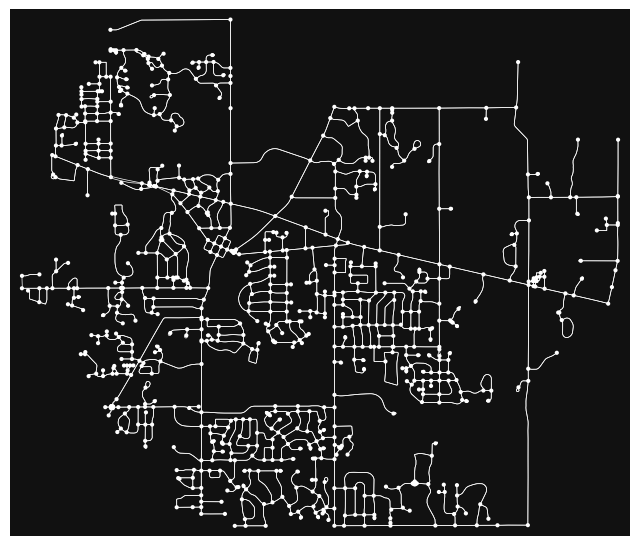

In [245]:
#plot the road network with id as label 
fig, ax = ox.plot_graph(G, node_size=9, edge_linewidth=0.5, edge_color="w", show=True, close=False)
#fig, ax = ox.plot_graph(G)

In [118]:
# convert your MultiDiGraph to an undirected MultiGraph
M = ox.utils_graph.get_undirected(G)

# convert your MultiDiGraph to a DiGraph without parallel edges
D = ox.utils_graph.get_digraph(G)

In [119]:
# you can convert your graph to node and edge GeoPandas GeoDataFrames
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)
gdf_nodes.head()

,y,x,highway,street_count,geometry
osmid,,,,,
184488007,42.732412,-84.385315,turning_loop,1,POINT (-84.38531 42.73241)
184488014,42.733746,-84.385264,NaN,3,POINT (-84.38526 42.73375)
184488050,42.692807,-84.414575,NaN,3,POINT (-84.41457 42.69281)
184492151,42.717686,-84.431320,NaN,3,POINT (-84.43132 42.71769)
184502002,42.698863,-84.410383,NaN,3,POINT (-84.41038 42.69886)


In [120]:
gdf_edges.head()

osmid              name      highway  oneway  \
u         v          key                                                     
184488007 184488014  0     17805690  Whitetail Circle  residential   False   
184488014 184488007  0     17805690  Whitetail Circle  residential   False   
          184550837  0    640291080       Tihart Road  residential   False   
          184594518  0    640291080       Tihart Road  residential   False   
184488050 8594185577 0     17811466    Yosemite Drive  residential   False   

                         reversed   length  \
u         v          key                     
184488007 184488014  0      False  148.453   
184488014 184488007  0       True  148.453   
          184550837  0      False  636.807   
          184594518  0       True  403.260   
184488050 8594185577 0      False   50.084   

                                                                   geometry  \
u         v          key                                                      
184488007 184488014  0    LINESTRING (-84.38531 42.73241, -84.38530 42.7...   
184488014 184488007  0    LINESTRING (-84.38526 42.73375, -84.38530 42.7...   
          184550837  0    LINESTRING (-84.38526 42.73375, -84.38625 42.7...   
          184594518  0    LINESTRING (-84.38526 42.73375, -84.38391 42.7...   
184488050 8594185577 0    LINESTRING (-84.41457 42.69281, -84.41442 42.6...   

                         lanes maxspeed bridge junction  ref  
u         v          key                                      
184488007 184488014  0     NaN      NaN    NaN      NaN  NaN  
184488014 184488007  0     NaN      NaN    NaN      NaN  NaN  
          184550837  0     NaN      NaN    NaN      NaN  NaN  
          184594518  0     NaN      NaN    NaN      NaN  NaN  
184488050 8594185577 0     NaN      NaN    NaN      NaN  NaN

In [121]:
# convert node/edge GeoPandas GeoDataFrames to a NetworkX MultiDiGraph
G2 = ox.graph_from_gdfs(gdf_nodes, gdf_edges, graph_attrs=G.graph)

In [122]:
# what sized area does our network cover in square meters?
G_proj = ox.project_graph(G)
nodes_proj = ox.graph_to_gdfs(G_proj, edges=False)
graph_area_m = nodes_proj.unary_union.convex_hull.area
graph_area_m

45148881.27621801

In [123]:
# show some basic stats about the network
ox.basic_stats(G_proj, area=graph_area_m, clean_int_tol=15)

{'n': 828,
 'm': 2235,
 'k_avg': 5.398550724637682,
 'edge_length_total': 409608.7310000004,
 'edge_length_avg': 183.2701257270695,
 'streets_per_node_avg': 2.8345410628019323,
 'streets_per_node_counts': {0: 0, 1: 105, 2: 8, 3: 635, 4: 79, 5: 1},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.12681159420289856,
  2: 0.00966183574879227,
  3: 0.7669082125603864,
  4: 0.09541062801932366,
  5: 0.0012077294685990338},
 'intersection_count': 723,
 'street_length_total': 207008.06699999992,
 'street_segment_count': 1154,
 'street_length_avg': 179.38307365684568,
 'circuity_avg': 1.1186643822092894,
 'self_loop_proportion': 0.07279029462738301,
 'clean_intersection_count': 664,
 'node_density_km': 18.339324842499376,
 'intersection_density_km': 16.01368582261721,
 'edge_density_km': 9072.40045426685,
 'street_density_km': 4585.009886148398,
 'clean_intersection_density_km': 14.706898182873896}

In [124]:
# convert graph to line graph so edges become nodes and vice versa
edge_centrality = nx.closeness_centrality(nx.line_graph(G))
nx.set_edge_attributes(G, edge_centrality, "edge_centrality")

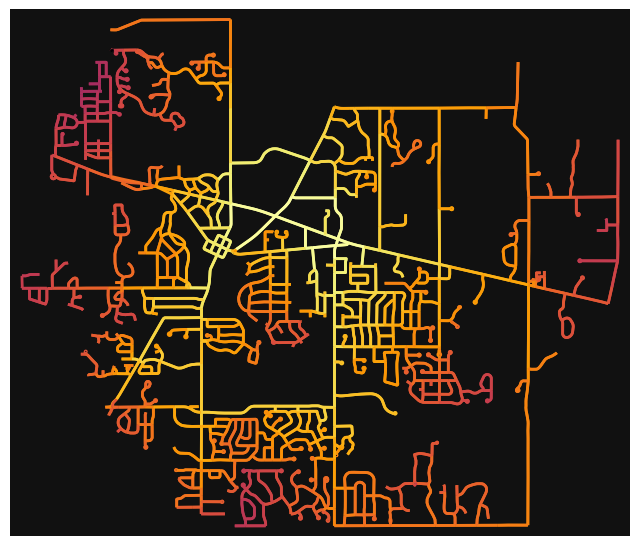

In [125]:
# color edges in original graph with closeness centralities from line graph
ec = ox.plot.get_edge_colors_by_attr(G, "edge_centrality", cmap="inferno")
fig, ax = ox.plot_graph(G, edge_color=ec, edge_linewidth=2, node_size=0)

In [126]:
# impute missing edge speeds and calculate edge travel times with the speed module
G = ox.speed.add_edge_speeds(G)
G = ox.speed.add_edge_travel_times(G)

In [129]:
# get the nearest network nodes to two lat/lng points with the distance module
orig = ox.distance.nearest_nodes(G, X= -84.480914, Y=42.737760)
dest = ox.distance.nearest_nodes(G, X=-84.412697, Y=42.693614)

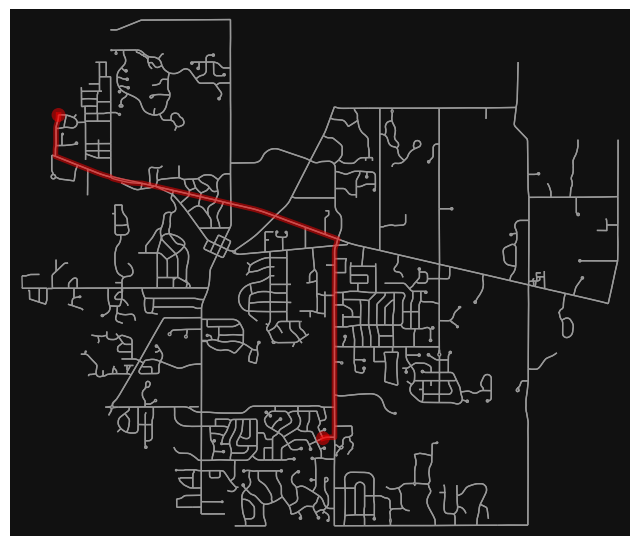

In [130]:
# find the shortest path between nodes, minimizing travel time, then plot it
route = ox.shortest_path(G, orig, dest, weight="travel_time")
fig, ax = ox.plot_graph_route(G, route, node_size=0)

In [131]:
# how long is our route in meters?
edge_lengths = ox.utils_graph.route_to_gdf(G, route)["length"]
round(sum(edge_lengths))

7400

In [132]:
# how far is it between these two nodes as the crow flies?
# use OSMnx's vectorized great-circle distance (haversine) function
orig_x = G.nodes[orig]["x"]
orig_y = G.nodes[orig]["y"]
dest_x = G.nodes[dest]["x"]
dest_y = G.nodes[dest]["y"]
round(ox.distance.great_circle(orig_y, orig_x, dest_y, dest_x))

5644

In [133]:
try:
    from keys import google_elevation_api_key

    G = ox.elevation.add_node_elevations_google(G, api_key=google_elevation_api_key)
    G = ox.elevation.add_edge_grades(G)
    nc = ox.plot.get_node_colors_by_attr(G, "elevation", cmap="plasma")
    fig, ax = ox.plot_graph(G, node_color=nc, node_size=20, edge_linewidth=2, edge_color="#333")
except ImportError:
    print("You need a google_elevation_api_key to run this cell.")

You need a google_elevation_api_key to run this cell.


In [134]:
Gp = ox.project_graph(G)
# randomly sample n points spatially-constrained to the network's geometry
points = ox.utils_geo.sample_points(ox.get_undirected(Gp), n=100)
X = points.x.values
Y = points.y.values
X0 = X.mean()
Y0 = Y.mean()

In [135]:
# find each nearest node to several points, and optionally return distance
nodes, dists = ox.nearest_nodes(Gp, X, Y, return_dist=True)

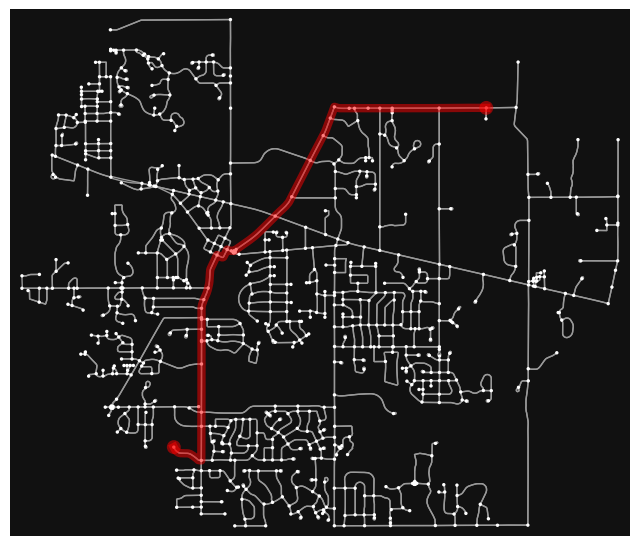

In [136]:
# find the shortest path (by distance) between these nodes then plot it
orig = list(G)[1]
dest = list(G)[120]
route = ox.shortest_path(G, orig, dest, weight="length")
fig, ax = ox.plot_graph_route(G, route, route_color="r", route_linewidth=6, node_size=6)

In [137]:
# impute speed on all edges missing data
G = ox.add_edge_speeds(G)

# calculate travel time (seconds) for all edges
G = ox.add_edge_travel_times(G)

In [138]:
# see mean speed/time values by road type
edges = ox.graph_to_gdfs(G, nodes=False)
edges["highway"] = edges["highway"].astype(str)
edges.groupby("highway")[["length", "speed_kph", "travel_time"]].mean().round(1)

,length,speed_kph,travel_time
highway,,,
residential,173.8,40.4,15.6
secondary,222.7,52.3,15.3
tertiary,224.7,60.1,13.3
unclassified,237.8,56.3,15.5


In [139]:
# same thing again, but this time pass in a few default speed values (km/hour)
# to fill in edges with missing `maxspeed` from OSM
hwy_speeds = {"residential": 35, "secondary": 50, "tertiary": 60}
G = ox.add_edge_speeds(G, hwy_speeds)
G = ox.add_edge_travel_times(G)

In [141]:
#show G dataframe with travel time
G.nodes.data()

NodeDataView({184488007: {'y': 42.7324116, 'x': -84.3853145, 'highway': 'turning_loop', 'street_count': 1}, 184488014: {'y': 42.733746, 'x': -84.385264, 'street_count': 3}, 184488050: {'y': 42.6928074, 'x': -84.4145747, 'street_count': 3}, 184492151: {'y': 42.717686, 'x': -84.43132, 'street_count': 3}, 184502002: {'y': 42.6988628, 'x': -84.4103831, 'street_count': 3}, 184514397: {'y': 42.7229442, 'x': -84.4174512, 'highway': 'traffic_signals', 'street_count': 3}, 184516488: {'y': 42.700562, 'x': -84.378316, 'street_count': 3}, 184520859: {'y': 42.7285444, 'x': -84.4473977, 'street_count': 3}, 184522784: {'y': 42.7214823, 'x': -84.393055, 'street_count': 3}, 184522840: {'y': 42.68755, 'x': -84.4324183, 'street_count': 3}, 184522844: {'y': 42.687537, 'x': -84.433814, 'street_count': 3}, 184522869: {'y': 42.68866, 'x': -84.436021, 'street_count': 3}, 184522886: {'y': 42.716234, 'x': -84.4268271, 'street_count': 3}, 184522894: {'y': 42.7165423, 'x': -84.4266446, 'street_count': 3}, 1845229

In [142]:
G.edges.data()

OutMultiEdgeDataView([(184488007, 184488014, {'osmid': 17805690, 'name': 'Whitetail Circle', 'highway': 'residential', 'oneway': False, 'reversed': False, 'length': 148.453, 'geometry': <LINESTRING (-84.385 42.732, -84.385 42.733, -84.385 42.733, -84.385 42.734)>, 'edge_centrality': 0.049124869883990514, 'speed_kph': 35.0, 'travel_time': 15.3}), (184488014, 184488007, {'osmid': 17805690, 'name': 'Whitetail Circle', 'highway': 'residential', 'oneway': False, 'reversed': True, 'length': 148.45300000000003, 'geometry': <LINESTRING (-84.385 42.734, -84.385 42.733, -84.385 42.733, -84.385 42.732)>, 'edge_centrality': 0.051668785364321804, 'speed_kph': 35.0, 'travel_time': 15.3}), (184488014, 184550837, {'osmid': 640291080, 'name': 'Tihart Road', 'highway': 'residential', 'oneway': False, 'reversed': False, 'length': 636.807, 'geometry': <LINESTRING (-84.385 42.734, -84.386 42.734, -84.388 42.734, -84.39 42.734, ...>, 'edge_centrality': 0.051668785364321804, 'speed_kph': 35.0, 'travel_time':

In [143]:
edges = ox.graph_to_gdfs(G, nodes=False)
edges["highway"] = edges["highway"].astype(str)
edges.groupby("highway")[["length", "speed_kph", "travel_time"]].mean().round(1)

,length,speed_kph,travel_time
highway,,,
residential,173.8,36.7,17.2
secondary,222.7,50.0,16.0
tertiary,224.7,60.1,13.3
unclassified,237.8,56.3,15.5


In [144]:
# calculate two routes by minimizing travel distance vs travel time
orig = list(G)[1]
dest = list(G)[120]
route1 = ox.shortest_path(G, orig, dest, weight="length")
route2 = ox.shortest_path(G, orig, dest, weight="travel_time")

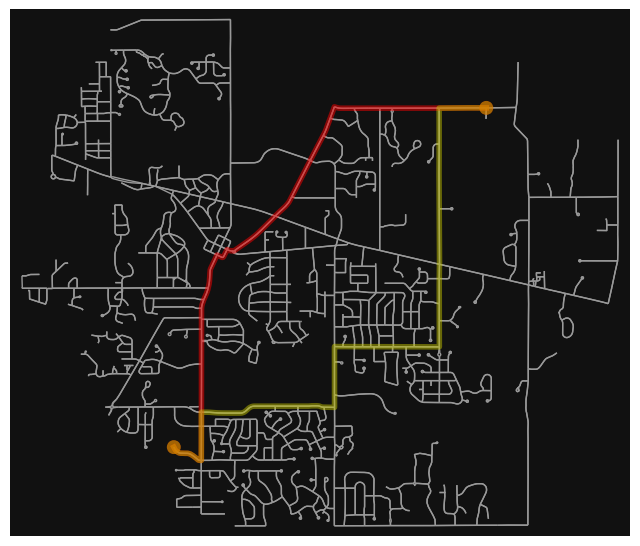

In [145]:
# plot the routes
fig, ax = ox.plot_graph_routes(
    G, routes=[route1, route2], route_colors=["r", "y"], route_linewidth=6, node_size=0
)

In [146]:
# compare the two routes
route1_length = int(sum(ox.utils_graph.route_to_gdf(G, route1, "length")["length"]))
route2_length = int(sum(ox.utils_graph.route_to_gdf(G, route2, "length")["length"]))
route1_time = int(sum(ox.utils_graph.route_to_gdf(G, route1, "travel_time")["travel_time"]))
route2_time = int(sum(ox.utils_graph.route_to_gdf(G, route2, "travel_time")["travel_time"]))
print("Route 1 is", route1_length, "meters and takes", route1_time, "seconds.")
print("Route 2 is", route2_length, "meters and takes", route2_time, "seconds.")

Route 1 is 8036 meters and takes 587 seconds.
Route 2 is 9024 meters and takes 572 seconds.


In [171]:
orig = list(G)[70]
orig
G.nodes[184528641]

{'y': 42.7129953, 'x': -84.3930459, 'street_count': 4}

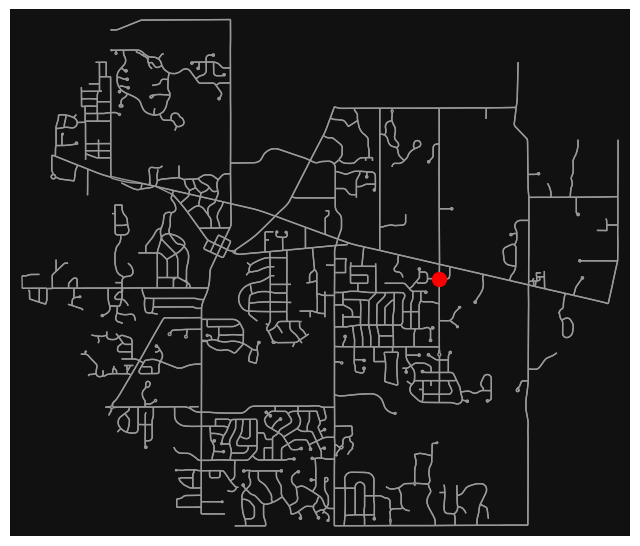

In [174]:
orig = list(G)[70]
#plot the orig point
fig, ax = ox.plot_graph(G, node_size=0, show=False, close=False)
ax.scatter(G.nodes[184528641]['x'],G.nodes[184528641]['y'], color='red', s=100)


In [186]:
orig = list(G)[70]
route_list = []
route_set = set()
for node in list(G):
    #print(node)
    if node in route_set:
        pass
    else:
        if node != orig:
            route =  ox.shortest_path(G, orig, node, weight="travel_time")
            if route == None:
                pass
            else:
                time = int(sum(ox.utils_graph.route_to_gdf(G, route, "travel_time")["travel_time"]))
                if time < 300:
                    route_list.append(route)
                    #add each element of the route to the set
                    for element in route:
                        route_set.add(element)



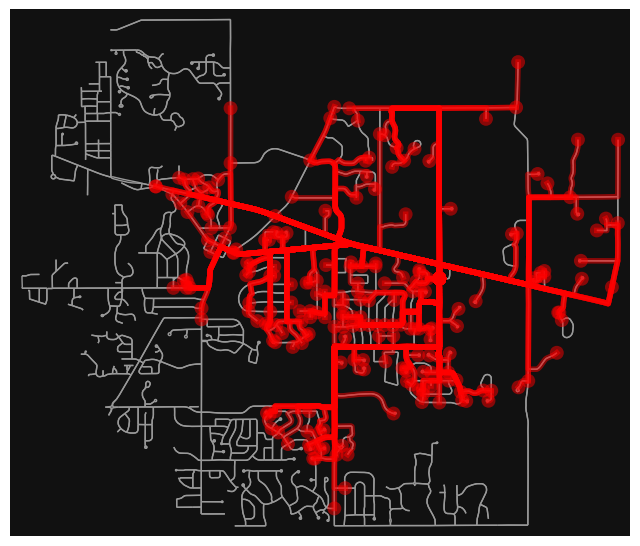

In [194]:
fig, ax = ox.plot_graph_routes(
    G, routes=route_list, route_colors = 'red', route_linewidth=3, node_size=0
)

In [177]:
orig = list(G)[70]
route_list = []

for node in list(G):
    if node != orig:
        route =  ox.shortest_path(G, orig, node, weight="travel_time")
        if route == None:
            pass
        else:
            
            time = int(sum(ox.utils_graph.route_to_gdf(G, route, "travel_time")["travel_time"]))
            if time < 120:
                route_list.append(route)

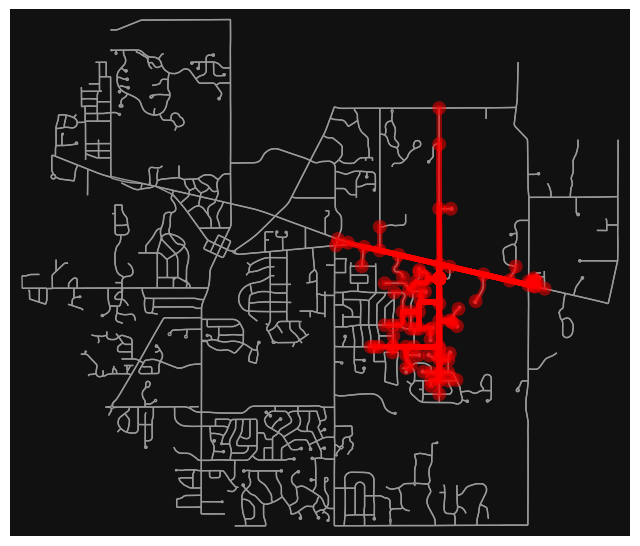

In [178]:
fig, ax = ox.plot_graph_routes(
    G, routes=route_list, route_linewidth=6, node_size=0
)

In [200]:
# get all the building footprints in a city
gdf = ox.features_from_place("okemos, michigan, USA", {"building": True})
gdf.shape

(7895, 132)

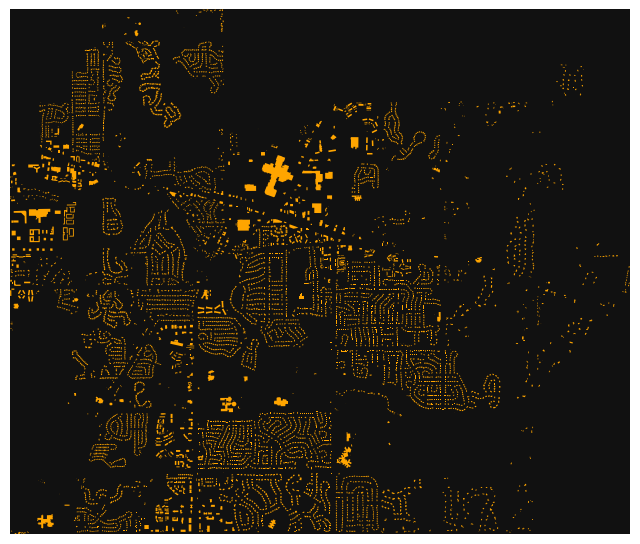

In [201]:

fig, ax = ox.plot_footprints(gdf)

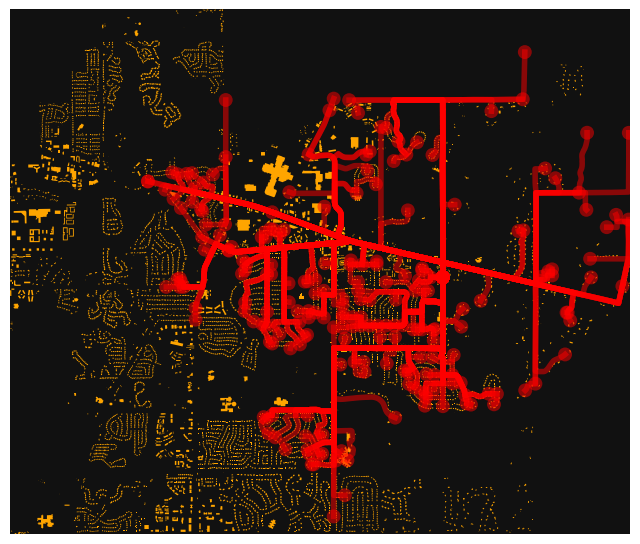

In [207]:
# or plot street network and the geospatial features' footprints together
fig, ax = ox.plot_footprints(gdf, alpha=1, show=False)

fig, ax = ox.plot_graph_routes(
    G, ax=ax, routes=route_list, route_linewidth=6, node_size=0
)
#fig, ax = ox.plot_graph(G, ax=ax, node_size=0, edge_color="w", edge_linewidth=0.7)

In [114]:
# fig, ax = ox.plot_footprints(gdf, alpha=0.4, show=False)
# #add routes to the plot
# fig, ax = ox.plot_graph_routes(
#     G, routes=route_list, route_linewidth=6, node_size=0
# )
# fig, ax = ox.plot_graph(G, ax=ax, node_size=0, edge_color="w", edge_linewidth=0.7)



In [208]:
import networkx as nx
import osmnx as ox

In [230]:
#!pip install folium matplotlib mapclassify

In [213]:
# download a street network then solve a shortest-path route on it
weight = "length"
G = ox.graph_from_place("okemos, MI, USA", network_type="drive")
orig = list(G.nodes)[0]
dest = list(G.nodes)[-1]
route = ox.shortest_path(G, orig, dest, weight=weight)

In [214]:
# explore graph edges interactively, with a simple one-liner
ox.graph_to_gdfs(G, nodes=False).explore()

In [215]:
# explore graph nodes interactively, with different basemap tiles
nodes = ox.graph_to_gdfs(G, edges=False)
nodes.explore(tiles="cartodbpositron", marker_kwds={"radius": 8})

In [216]:
# explore nodes and edges together in a single map
nodes, edges = ox.graph_to_gdfs(G)
m = edges.explore(color="skyblue", tiles="cartodbdarkmatter")
nodes.explore(m=m, color="pink", marker_kwds={"radius": 6})

In [217]:
# explore graph edges interactively, colored by length
edges.explore(tiles="cartodbdarkmatter", column="length", cmap="plasma")

In [218]:
# explore graph nodes interactively, colored by betweenness centrality
nx.set_node_attributes(G, nx.betweenness_centrality(G, weight="length"), name="bc")
nodes = ox.graph_to_gdfs(G, edges=False)
nodes.explore(tiles="cartodbdarkmatter", column="bc", marker_kwds={"radius": 8})

In [219]:
# explore a route interactively
route_edges = ox.utils_graph.route_to_gdf(G, route, weight)
route_edges.explore(tiles="cartodbpositron", style_kwds={"weight": 5})

In [220]:
# explore graph edges and route together in a single map
m = edges.explore(color="maroon", tiles="cartodbdarkmatter")
m = route_edges.explore(m=m, color="yellow", style_kwds={"weight": 5})
m

In [221]:
# or explore multiple routes together in a single map
routes = ox.k_shortest_paths(G, orig, dest, k=200, weight=weight)
gdfs = (ox.utils_graph.route_to_gdf(G, route, weight=weight) for route in routes)
m = edges.explore(color="#222222", tiles="cartodbdarkmatter")
for route_edges in gdfs:
    m = route_edges.explore(m=m, color="cyan", style_kwds={"weight": 5, "opacity": 0.05})
m

In [222]:
# define some options
place = "okemos, MI, USA"
tiles = "cartodbdarkmatter"
mk = {"radius": 6}

In [225]:
# explore a city's parks interactively
parks = ox.features_from_place(place, tags={"leisure": "park"})
parks.explore(tiles=tiles, color="lime", tooltip="name")

In [228]:
# explore a neighborhood's buildings interactively
gdf = ox.features_from_place("SoHo, New York, NY", tags={"building": True})
cols = ["height", "addr:housenumber", "addr:street", "addr:postcode"]
gdf.explore(tiles="cartodbdarkmatter", tooltip=cols)

In [229]:
# explore a neighborhood's buildings + street network interactively
place = "SoHo, New York, NY"
cols = ["height", "addr:housenumber", "addr:street", "addr:postcode"]
G = ox.graph_from_place(place, network_type="drive", truncate_by_edge=True)
gdf = ox.features_from_place(place, tags={"building": True})
m = gdf.explore(tiles=tiles, tooltip=cols)
ox.graph_to_gdfs(G, nodes=False).explore(m=m, color="yellow")